# Step 2 (Load dataset, EDA, and preprocess)

In [16]:
import cv2
import matplotlib.pyplot as plt
import os
import random
import kagglehub
from kagglehub import KaggleDatasetAdapter
import yaml
import collections
import numpy as np
from PIL import Image

In [17]:
# kagglehub.dataset_download('slavkoprytula/aquarium-data-cots')

In [18]:
# !mkdir datasets
# !mv /kaggle/input/aquarium-data-cots/aquarium_pretrain /content/datasets/
# !cat ./datasets/aquarium_pretrain/README.dataset.txt

## Load Dataset and Show Samples

### Load Dataset Configuration


In [24]:
dataset_path = 'datasets/aquarium_pretrain'
data_yaml_path = os.path.join(dataset_path, 'data.yaml')

with open(data_yaml_path, 'r') as f:
    data_config = yaml.safe_load(f)

class_names = data_config['names']
num_classes = data_config['nc']

print(f"Class Names: {class_names}")
print(f"Number of Classes: {num_classes}")

Class Names: ['fish', 'jellyfish', 'penguin', 'puffin', 'shark', 'starfish', 'stingray']
Number of Classes: 7


### Prepare Training Data Paths


In [26]:
train_images_dir = os.path.join(dataset_path, data_config['train'].replace('../', ''))
train_labels_dir = os.path.join(dataset_path, data_config['train'].replace('images', 'labels').replace('../', ''))

train_image_paths = []
train_label_paths = []

for img_filename in os.listdir(train_images_dir):
    if img_filename.endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(train_images_dir, img_filename)
        label_filename = img_filename.rsplit('.', 1)[0] + '.txt'
        label_path = os.path.join(train_labels_dir, label_filename)

        if os.path.exists(label_path):
            train_image_paths.append(image_path)
            train_label_paths.append(label_path)

print(f"Total training images found: {len(train_image_paths)}")
print(f"Total training labels found: {len(train_label_paths)}")

Total training images found: 448
Total training labels found: 448


### Define Bounding Box Visualization Function

In [27]:
def plot_bounding_boxes(image_path, label_path, class_names):
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error: Could not load image from {image_path}")
        return

    # Convert BGR to RGB for Matplotlib display
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    H, W, _ = img_rgb.shape

    # Load label data
    try:
        with open(label_path, 'r') as f:
            labels = f.readlines()
    except FileNotFoundError:
        print(f"Error: Label file not found at {label_path}")
        plt.imshow(img_rgb)
        plt.title(os.path.basename(image_path))
        plt.axis('off')
        plt.show()
        return

    for label in labels:
        parts = list(map(float, label.strip().split()))
        class_id = int(parts[0])
        center_x_norm, center_y_norm, width_norm, height_norm = parts[1:]

        # Convert normalized coordinates to absolute pixel coordinates
        center_x = int(center_x_norm * W)
        center_y = int(center_y_norm * H)
        box_width = int(width_norm * W)
        box_height = int(height_norm * H)

        # Calculate top-left and bottom-right corners
        x1 = int(center_x - box_width / 2)
        y1 = int(center_y - box_height / 2)
        x2 = int(center_x + box_width / 2)
        y2 = int(center_y + box_height / 2)

        # Draw rectangle
        color = (0, 255, 0) # Green in RGB
        cv2.rectangle(img_rgb, (x1, y1), (x2, y2), color, 2)

        # Put class label
        class_name = class_names[class_id]
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 0.7
        font_thickness = 2
        text_size = cv2.getTextSize(class_name, font, font_scale, font_thickness)[0]
        text_x = x1
        text_y = y1 - 10 if y1 - 10 > 10 else y1 + text_size[1] + 10 # Adjust text position
        cv2.putText(img_rgb, class_name, (text_x, text_y), font, font_scale, color, font_thickness, cv2.LINE_AA)

    # Display the image
    plt.figure(figsize=(10, 8))
    plt.imshow(img_rgb)
    plt.title(os.path.basename(image_path))
    plt.axis('off')
    plt.show()

### Display Random Training Images with Bounding Boxes


Displaying 10 random training images with bounding boxes...
Image: IMG_8357_jpg.rf.e2bd534646a7aa8e2cc4a767e41786e1.jpg, Label: IMG_8357_jpg.rf.e2bd534646a7aa8e2cc4a767e41786e1.txt


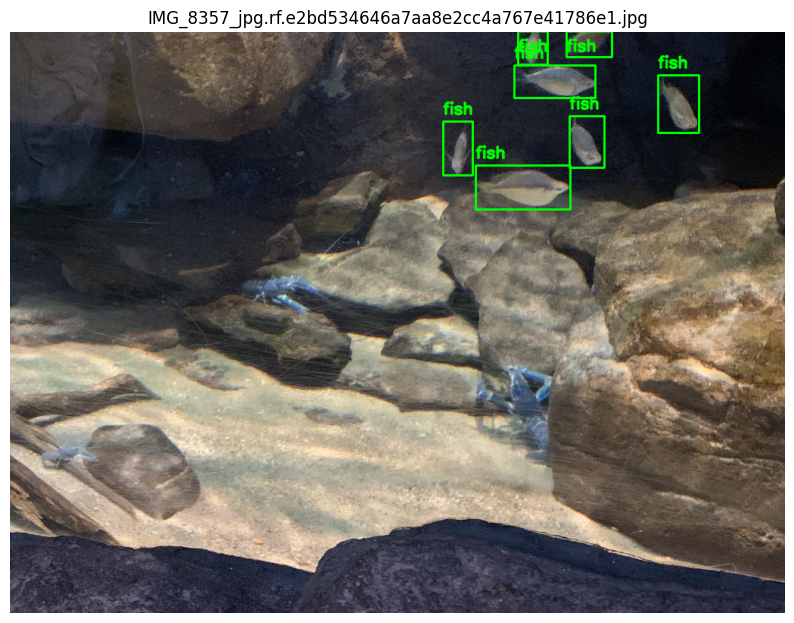

Image: IMG_2417_jpeg_jpg.rf.3126d833b440a93a98942375d5de1a91.jpg, Label: IMG_2417_jpeg_jpg.rf.3126d833b440a93a98942375d5de1a91.txt


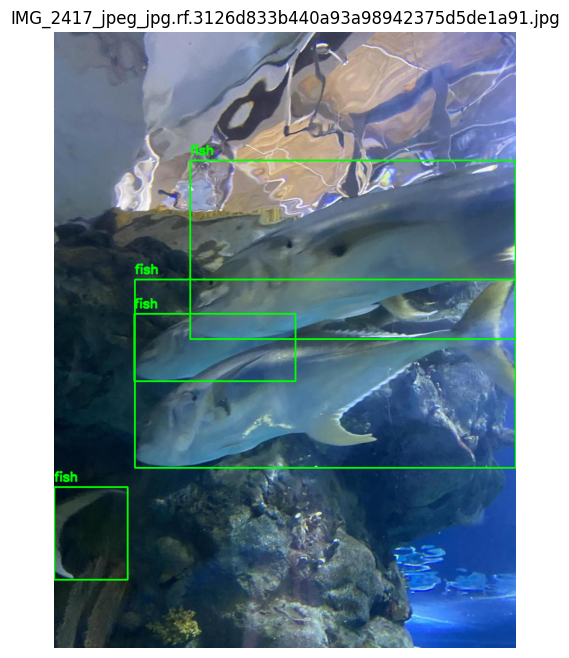

Image: IMG_2592_jpeg_jpg.rf.9c8ada079979c004ab05f15d6b66c902.jpg, Label: IMG_2592_jpeg_jpg.rf.9c8ada079979c004ab05f15d6b66c902.txt


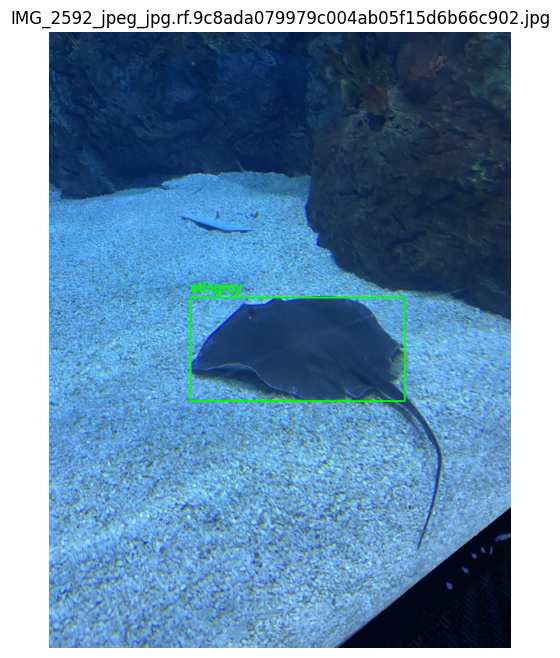

Image: IMG_2462_jpeg_jpg.rf.996656c68077c9d9e7ec2c4928a5c4d1.jpg, Label: IMG_2462_jpeg_jpg.rf.996656c68077c9d9e7ec2c4928a5c4d1.txt


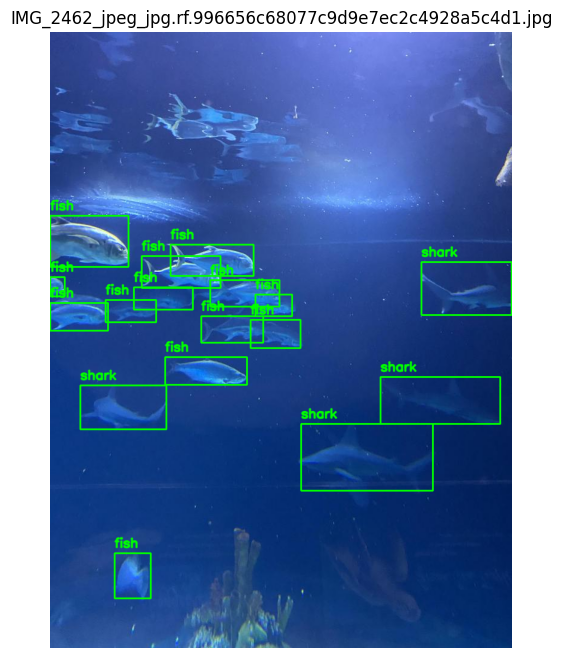

Image: IMG_8468_jpg.rf.6a748d130991418e3da8737f17ba5e73.jpg, Label: IMG_8468_jpg.rf.6a748d130991418e3da8737f17ba5e73.txt


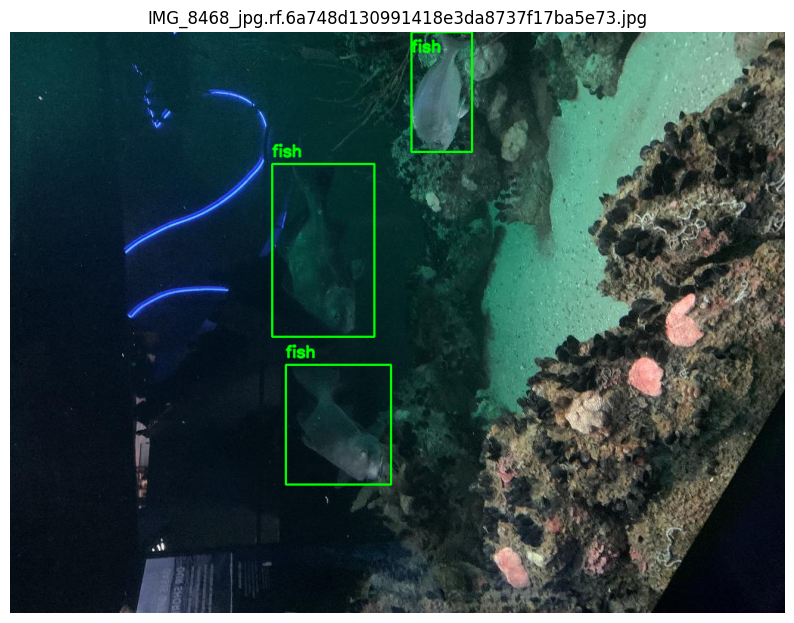

Image: IMG_2528_jpeg_jpg.rf.2bd17b3a6751de79eab0f91356230d98.jpg, Label: IMG_2528_jpeg_jpg.rf.2bd17b3a6751de79eab0f91356230d98.txt


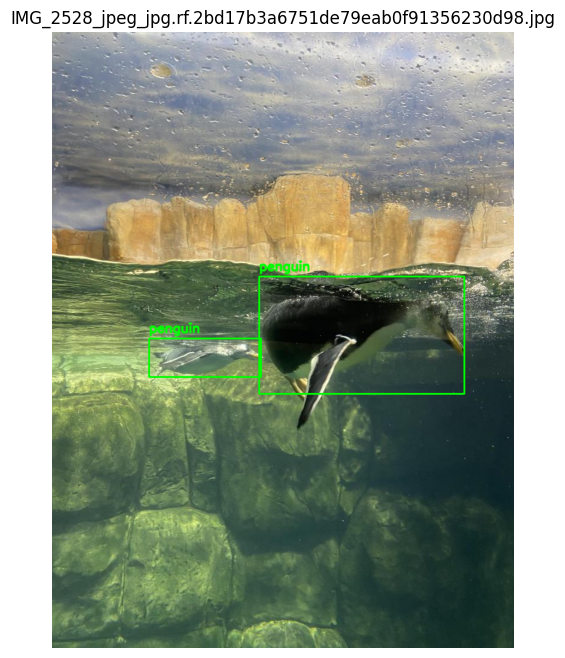

Image: IMG_2639_jpeg_jpg.rf.44073e788a70dcd9df5e84d85f16a602.jpg, Label: IMG_2639_jpeg_jpg.rf.44073e788a70dcd9df5e84d85f16a602.txt


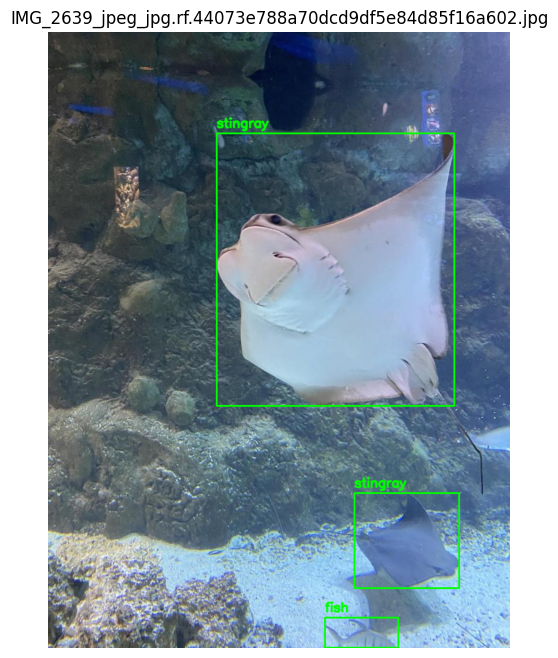

Image: IMG_2606_jpeg_jpg.rf.27e5a373d43d2535a923e1089bf60051.jpg, Label: IMG_2606_jpeg_jpg.rf.27e5a373d43d2535a923e1089bf60051.txt


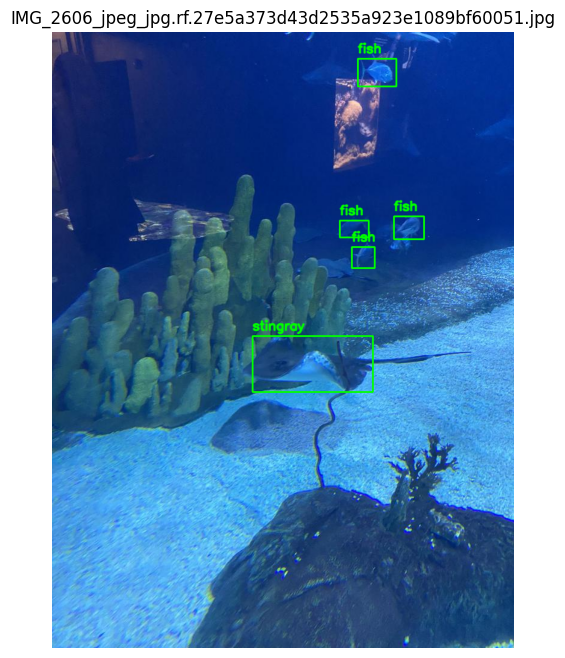

Image: IMG_2549_jpeg_jpg.rf.d9307c4549bb67163bb43c81fb771cd8.jpg, Label: IMG_2549_jpeg_jpg.rf.d9307c4549bb67163bb43c81fb771cd8.txt


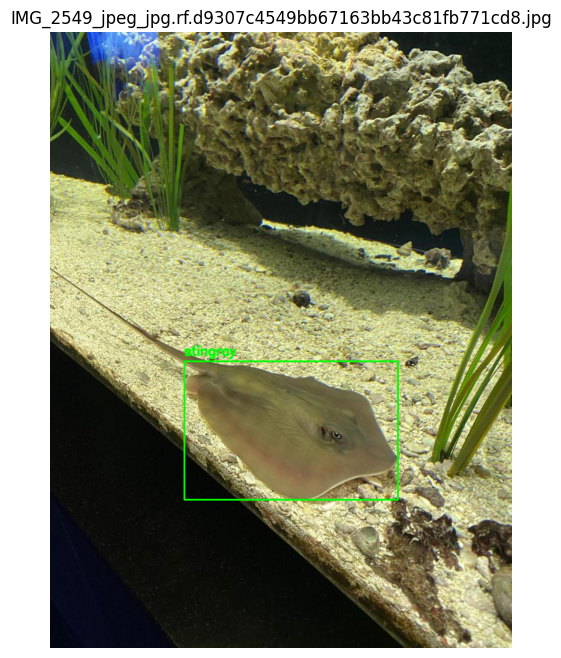

Image: IMG_2618_jpeg_jpg.rf.10bc0b28fb5d6b893602833d791c4dff.jpg, Label: IMG_2618_jpeg_jpg.rf.10bc0b28fb5d6b893602833d791c4dff.txt


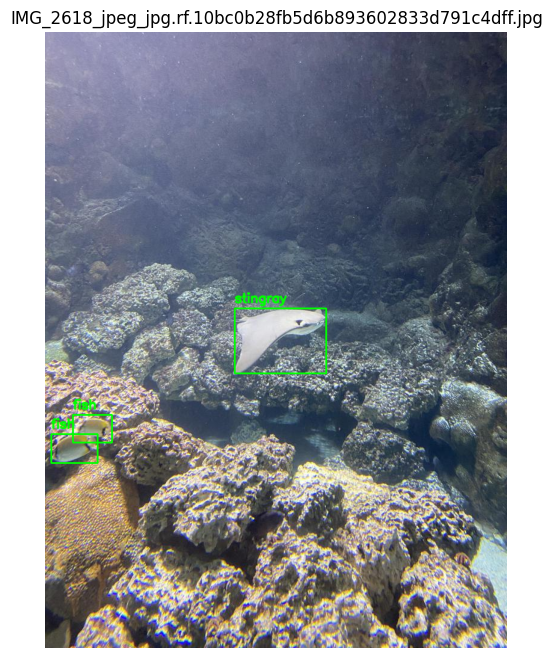

In [28]:
num_samples = 10
random_indices = random.sample(range(len(train_image_paths)), min(num_samples, len(train_image_paths)))

print(f"Displaying {len(random_indices)} random training images with bounding boxes...")

for i in random_indices:
    image_path = train_image_paths[i]
    label_path = train_label_paths[i]

    print(f"Image: {os.path.basename(image_path)}, Label: {os.path.basename(label_path)}")
    plot_bounding_boxes(image_path, label_path, class_names)

## EDA

### Parse Label Data for Statistics

In [29]:
all_class_ids = []
objects_per_image = []
all_bbox_widths = []
all_bbox_heights = []
all_bbox_aspect_ratios = []

for img_path, lbl_path in zip(train_image_paths, train_label_paths):
    img = cv2.imread(img_path)
    if img is None:
        print(f"Warning: Could not load image from {img_path}. Skipping.")
        continue

    H, W, _ = img.shape
    current_image_objects = 0

    try:
        with open(lbl_path, 'r') as f:
            labels = f.readlines()
    except FileNotFoundError:
        print(f"Warning: Label file not found at {lbl_path}. Skipping.")
        continue

    for label_line in labels:
        parts = list(map(float, label_line.strip().split()))
        class_id = int(parts[0])
        _, _, norm_width, norm_height = parts[1:]

        # Convert normalized width and height to absolute pixel values
        abs_width = norm_width * W
        abs_height = norm_height * H

        # Calculate aspect ratio
        aspect_ratio = abs_width / abs_height if abs_height != 0 else 0

        all_class_ids.append(class_id)
        all_bbox_widths.append(abs_width)
        all_bbox_heights.append(abs_height)
        all_bbox_aspect_ratios.append(aspect_ratio)
        current_image_objects += 1

    objects_per_image.append(current_image_objects)

print(f"Total class IDs extracted: {len(all_class_ids)}")
print(f"Total images processed for object counts: {len(objects_per_image)}")
print(f"Total bounding box widths extracted: {len(all_bbox_widths)}")
print(f"Total bounding box heights extracted: {len(all_bbox_heights)}")
print(f"Total bounding box aspect ratios extracted: {len(all_bbox_aspect_ratios)}")

Total class IDs extracted: 3324
Total images processed for object counts: 448
Total bounding box widths extracted: 3324
Total bounding box heights extracted: 3324
Total bounding box aspect ratios extracted: 3324


### Calculate and Visualize Some Statisitcs

In [30]:
class_image_counts = collections.defaultdict(int)

for lbl_path in train_label_paths:
    try:
        with open(lbl_path, 'r') as f:
            labels = f.readlines()
    except FileNotFoundError:
        print(f"Warning: Label file not found at {lbl_path}. Skipping.")
        continue

    # Get unique class IDs for the current image
    unique_class_ids_in_image = set()
    for label_line in labels:
        parts = list(map(float, label_line.strip().split()))
        class_id = int(parts[0])
        unique_class_ids_in_image.add(class_id)

    # Increment count for each unique class in this image
    for class_id in unique_class_ids_in_image:
        class_image_counts[class_id] += 1

print("Class Image Counts:")
for class_id, count in sorted(class_image_counts.items()):
    print(f"  Class {class_id} ({class_names[class_id]}): {count} images")

Class Image Counts:
  Class 0 (fish): 240 images
  Class 1 (jellyfish): 32 images
  Class 2 (penguin): 47 images
  Class 3 (puffin): 45 images
  Class 4 (shark): 134 images
  Class 5 (starfish): 37 images
  Class 6 (stingray): 91 images


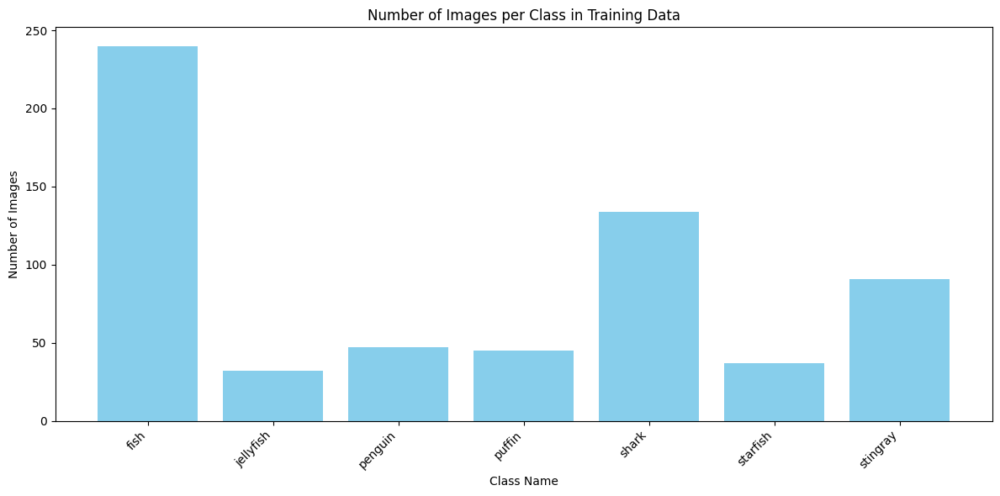

In [31]:
class_ids_sorted = sorted(class_image_counts.keys())
class_names_for_plot = [class_names[class_id] for class_id in class_ids_sorted]
image_counts_for_plot = [class_image_counts[class_id] for class_id in class_ids_sorted]

# Create the bar chart
plt.figure(figsize=(12, 6))
plt.bar(class_names_for_plot, image_counts_for_plot, color='skyblue')

plt.xlabel('Class Name')
plt.ylabel('Number of Images')
plt.title('Number of Images per Class in Training Data')

plt.xticks(rotation=45, ha='right')

# Ensure layout is tight to prevent labels from overlapping
plt.tight_layout()

plt.show()


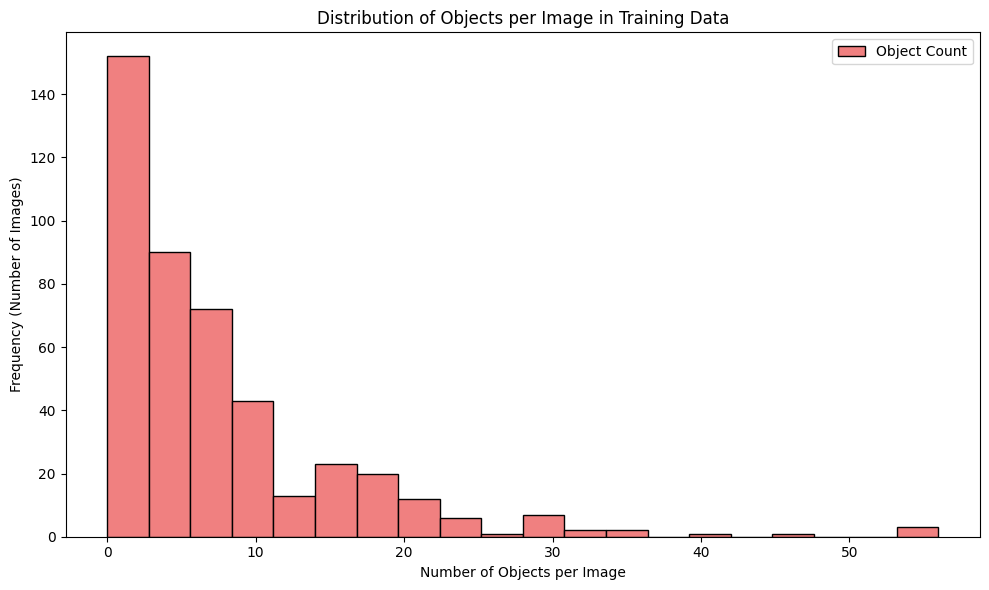

In [32]:
plt.figure(figsize=(10, 6))
plt.hist(objects_per_image, bins=20, color='lightcoral', edgecolor='black')

plt.xlabel('Number of Objects per Image')
plt.ylabel('Frequency (Number of Images)')
plt.title('Distribution of Objects per Image in Training Data')

plt.legend(['Object Count'])

# Ensure layout is tight
plt.tight_layout()

plt.show()

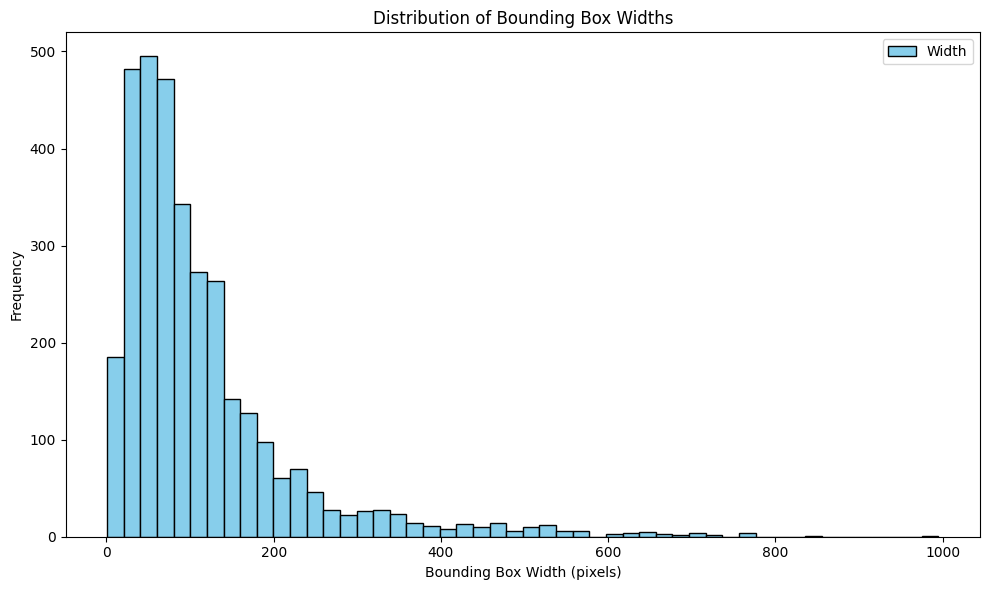

In [33]:
plt.figure(figsize=(10, 6))
plt.hist(all_bbox_widths, bins=50, color='skyblue', edgecolor='black')

plt.xlabel('Bounding Box Width (pixels)')
plt.ylabel('Frequency')
plt.title('Distribution of Bounding Box Widths')

plt.legend(['Width'])

# Ensure layout is tight
plt.tight_layout()

plt.show()

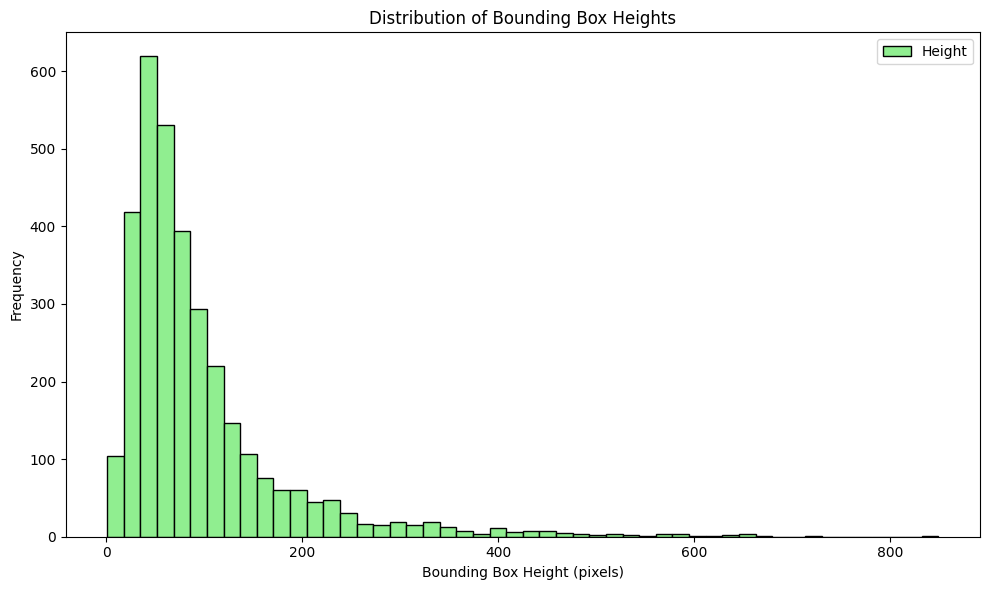

In [34]:
plt.figure(figsize=(10, 6))
plt.hist(all_bbox_heights, bins=50, color='lightgreen', edgecolor='black')

plt.xlabel('Bounding Box Height (pixels)')
plt.ylabel('Frequency')
plt.title('Distribution of Bounding Box Heights')

plt.legend(['Height'])

# Ensure layout is tight
plt.tight_layout()

plt.show()

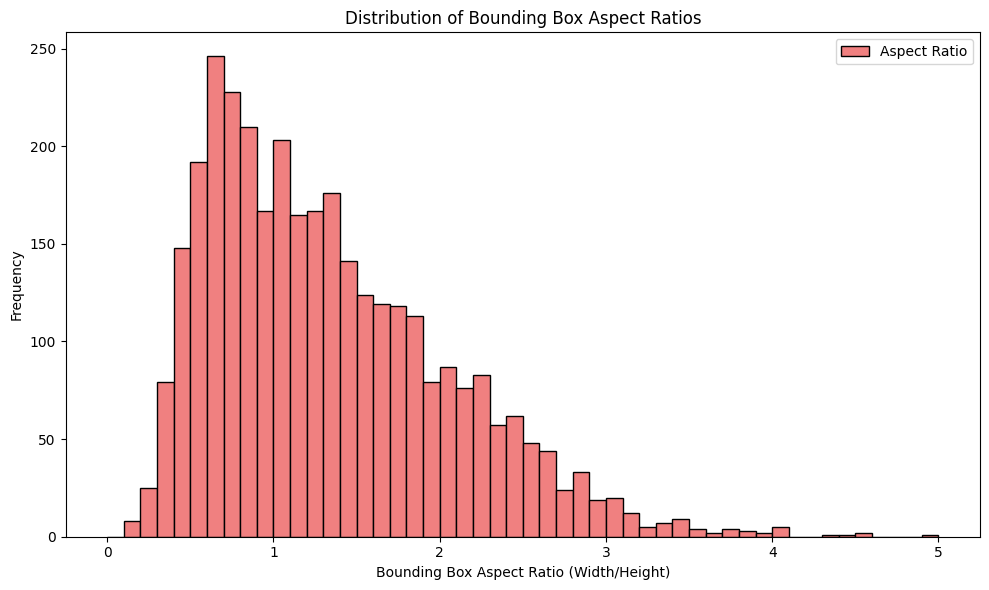

In [35]:
plt.figure(figsize=(10, 6))
plt.hist(all_bbox_aspect_ratios, bins=50, color='lightcoral', edgecolor='black', range=(0, 5)) # Limiting range to focus on common aspect ratios

plt.xlabel('Bounding Box Aspect Ratio (Width/Height)')
plt.ylabel('Frequency')
plt.title('Distribution of Bounding Box Aspect Ratios')

plt.legend(['Aspect Ratio'])

# Ensure layout is tight
plt.tight_layout()

plt.show()

## Data Preprocessing

### Check for Corrupted Images and Data Quality

In [36]:
def check_image_quality(image_path, label_path):
    try:
        img = cv2.imread(image_path)
        if img is None:
            return False, "Cannot load with OpenCV"
        
        h, w, c = img.shape
        if h < 10 or w < 10:
            return False, f"Image too small: {w}x{h}"
        
        if c != 3:
            return False, f"Invalid channels: {c} (expected 3)"
        
        # Check if image is completely black or white
        mean_val = np.mean(img)
        if mean_val < 5:
            return False, "Image too dark (nearly black)"
        if mean_val > 250:
            return False, "Image too bright (nearly white)"
        
        # Try loading with PIL as double check
        pil_img = Image.open(image_path)
        pil_img.verify()
        
        # Check label file
        if not os.path.exists(label_path):
            return False, "Label file missing"
        
        with open(label_path, 'r') as f:
            labels = f.readlines()
            if len(labels) == 0:
                return False, "Empty label file"
        
        return True, "OK"
    
    except Exception as e:
        return False, f"Exception: {str(e)}"

# Check all training images
print("Checking image and label quality...")
valid_image_paths = []
valid_label_paths = []
corrupted_images = []

for img_path, lbl_path in zip(train_image_paths, train_label_paths):
    is_valid, reason = check_image_quality(img_path, lbl_path)
    
    if is_valid:
        valid_image_paths.append(img_path)
        valid_label_paths.append(lbl_path)
    else:
        corrupted_images.append((img_path, reason))

print(f"\nQuality Check Results:")
print(f"  Total images checked: {len(train_image_paths)}")
print(f"  Valid images: {len(valid_image_paths)}")
print(f"  Corrupted/Invalid images: {len(corrupted_images)}")

if corrupted_images:
    print(f"\nCorrupted images found:")
    for img_path, reason in corrupted_images[:10]:  # Show first 10
        print(f"  - {os.path.basename(img_path)}: {reason}")
    if len(corrupted_images) > 10:
        print(f"  ... and {len(corrupted_images) - 10} more")

# Update training paths with valid images only
train_image_paths = valid_image_paths
train_label_paths = valid_label_paths

print(f"\nUpdated training set size: {len(train_image_paths)} images")

Checking image and label quality...

Quality Check Results:
  Total images checked: 448
  Valid images: 447
  Corrupted/Invalid images: 1

Corrupted images found:
  - IMG_3133_jpeg_jpg.rf.f439b9d382fd153b96f0a88cdf169172.jpg: Empty label file

Updated training set size: 447 images


### Define Preprocessing Functions

In [37]:
def resize_image_and_boxes(image, boxes, target_size=(800, 800), keep_aspect_ratio=True):
    h, w = image.shape[:2]
    target_w, target_h = target_size
    
    if keep_aspect_ratio:
        # Calculate scaling factor
        scale = min(target_w / w, target_h / h)
        new_w = int(w * scale)
        new_h = int(h * scale)
        
        resized = cv2.resize(image, (new_w, new_h), interpolation=cv2.INTER_LINEAR)
        
        padded = np.zeros((target_h, target_w, 3), dtype=np.uint8)
        
        pad_x = (target_w - new_w) // 2
        pad_y = (target_h - new_h) // 2
        
        padded[pad_y:pad_y + new_h, pad_x:pad_x + new_w] = resized
        
        adjusted_boxes = []
        for box in boxes:
            class_id, x_center, y_center, box_w, box_h = box
            
            # Convert to pixel coordinates in original image
            x_center_px = x_center * w
            y_center_px = y_center * h
            box_w_px = box_w * w
            box_h_px = box_h * h
            
            # Scale and add padding
            x_center_new = (x_center_px * scale + pad_x)
            y_center_new = (y_center_px * scale + pad_y)
            box_w_new = box_w_px * scale
            box_h_new = box_h_px * scale
            
            # Normalize to new image size
            x_center_norm = x_center_new / target_w
            y_center_norm = y_center_new / target_h
            box_w_norm = box_w_new / target_w
            box_h_norm = box_h_new / target_h
            
            adjusted_boxes.append((class_id, x_center_norm, y_center_norm, box_w_norm, box_h_norm))
        
        return padded, adjusted_boxes, scale
    
    else:
        # Simple resize without maintaining aspect ratio
        resized = cv2.resize(image, target_size, interpolation=cv2.INTER_LINEAR)
        # Boxes remain in normalized format, so they don't need adjustment
        return resized, boxes, (target_w / w, target_h / h)


def normalize_image(image, method='standard'):
    image = image.astype(np.float32)
    
    if method == 'standard':
        # Scale to [0, 1]
        normalized = image / 255.0
    
    elif method == 'imagenet':
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        # ImageNet mean and std
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        normalized = (image_rgb / 255.0 - mean) / std
    
    elif method == 'minmax':
        # Min-max normalization
        min_val = np.min(image)
        max_val = np.max(image)
        if max_val - min_val > 0:
            normalized = (image - min_val) / (max_val - min_val)
        else:
            normalized = image / 255.0
    
    else:
        normalized = image / 255.0
    
    return normalized


def preprocess_image(image_path, label_path, target_size=(800, 800), 
                    normalize=True, normalization_method='standard'):
    
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Cannot load image: {image_path}")
    
    original_image = image.copy()
    
    # Load boxes
    boxes = []
    with open(label_path, 'r') as f:
        for line in f.readlines():
            parts = list(map(float, line.strip().split()))
            boxes.append(tuple(parts))
    
    # Resize image and adjust boxes
    image, boxes, scale = resize_image_and_boxes(image, boxes, target_size=target_size, 
                                                keep_aspect_ratio=True)
    
    # Normalize
    if normalize:
        display_image = image.copy()  # Keep a copy for display
        image = normalize_image(image, method=normalization_method)
    else:
        display_image = image
    
    return image, boxes, original_image, display_image


print("Preprocessing functions defined successfully!")

Preprocessing functions defined successfully!


### Visualize Preprocessing Effects

Visualizing preprocessing effects on random samples...


Sample: IMG_2629_jpeg_jpg.rf.123294d0d4c352dd3481382281ce7ab8.jpg


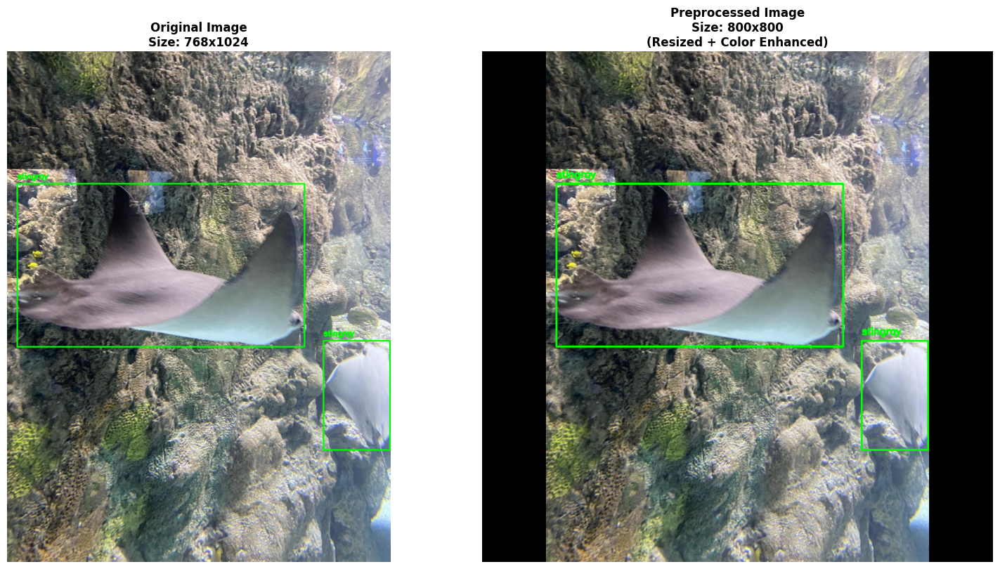


Sample: IMG_2475_jpeg_jpg.rf.46e62539bfeb76e003100176a5818f0b.jpg


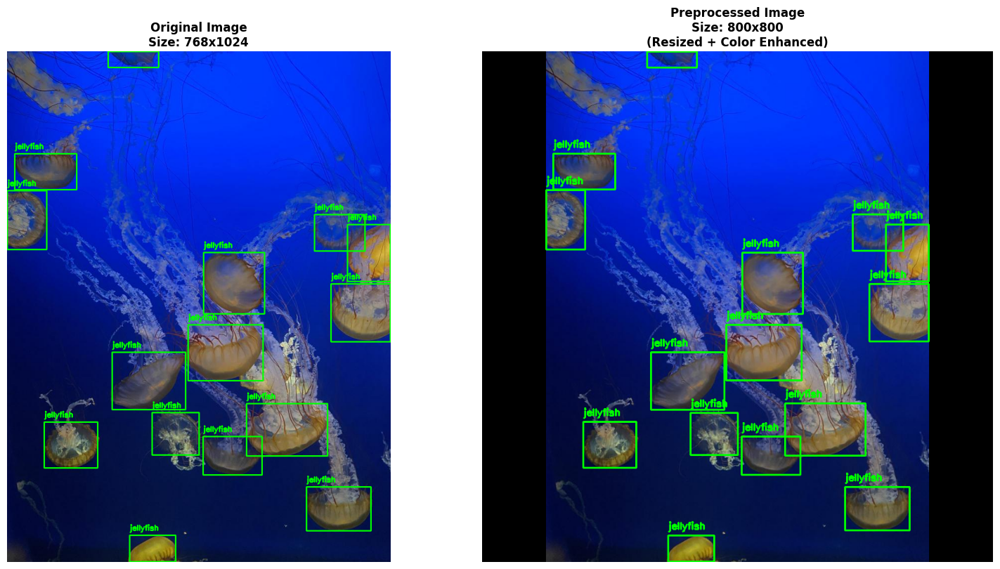


Sample: IMG_2415_jpeg_jpg.rf.ebf0f6afed62125f3a07b177ff1eb41b.jpg


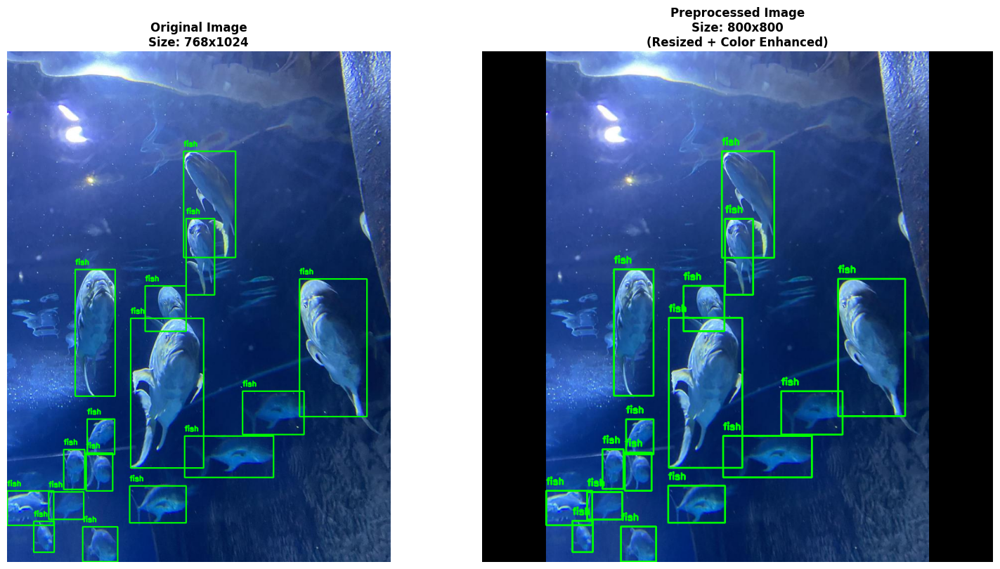


Sample: IMG_2350_jpeg_jpg.rf.c77c8bea4bbacefbccb48673c5f40171.jpg


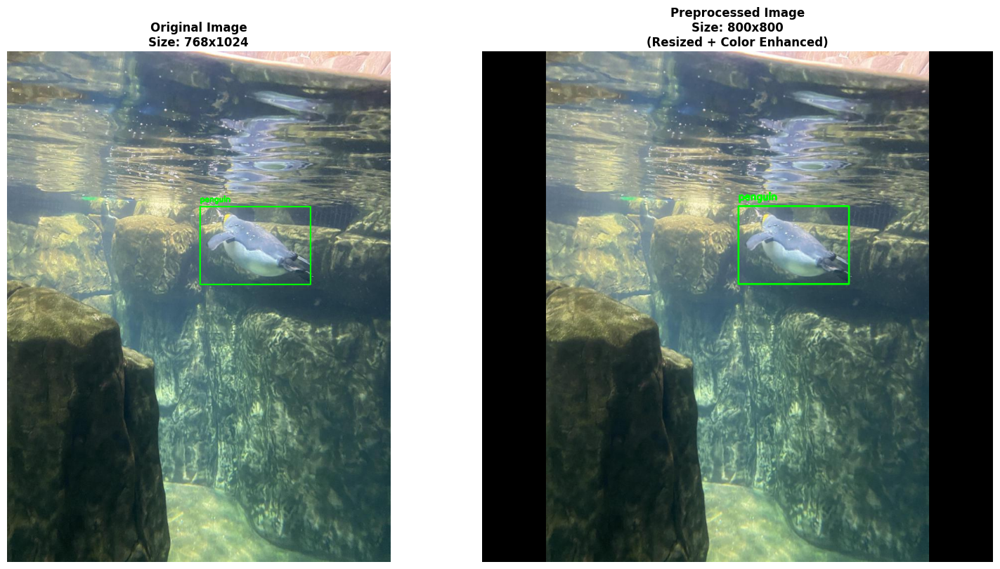


Sample: IMG_2401_jpeg_jpg.rf.9c2bfe2fea5904ab85682c15ea13eeac.jpg


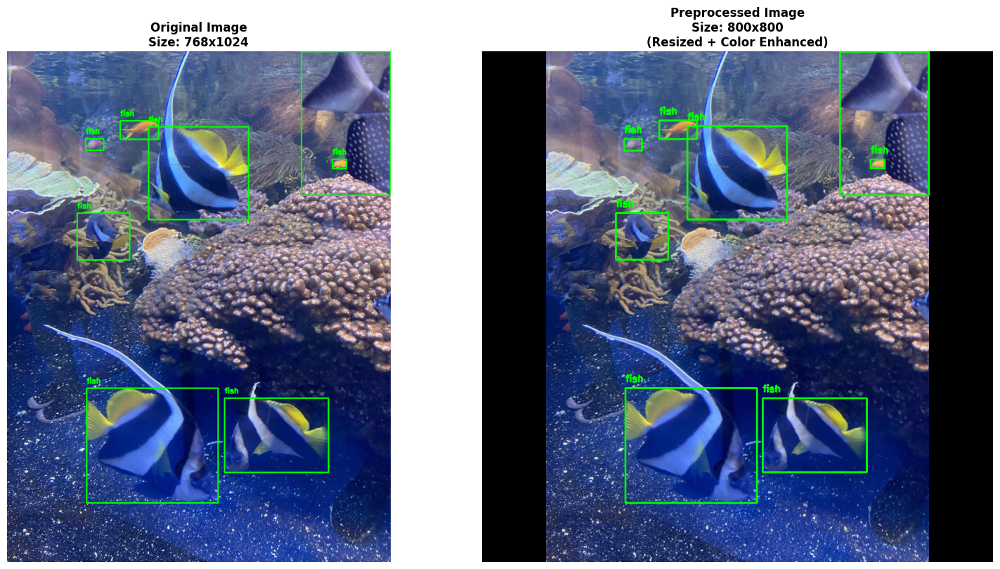

In [39]:
def plot_preprocessing_comparison(image_path, label_path, target_size=(800, 800)):
    # Load original
    original = cv2.imread(image_path)
    original_rgb = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
    
    # Load labels
    with open(label_path, 'r') as f:
        labels = [list(map(float, line.strip().split())) for line in f.readlines()]
    
    # Preprocess
    processed, boxes_adjusted, _, display_image = preprocess_image(
        image_path, label_path, 
        target_size=target_size,
        # apply_color_correction=True,
        normalize=False  # Don't normalize for visualization
    )
    
    processed_rgb = cv2.cvtColor(display_image, cv2.COLOR_BGR2RGB)
    
    # Draw boxes on original
    H_orig, W_orig = original_rgb.shape[:2]
    for label in labels:
        class_id = int(label[0])
        x_c, y_c, w, h = label[1:]
        
        x1 = int((x_c - w/2) * W_orig)
        y1 = int((y_c - h/2) * H_orig)
        x2 = int((x_c + w/2) * W_orig)
        y2 = int((y_c + h/2) * H_orig)
        
        cv2.rectangle(original_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(original_rgb, class_names[class_id], (x1, y1-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    
    # Draw boxes on preprocessed
    H_proc, W_proc = processed_rgb.shape[:2]
    for box in boxes_adjusted:
        class_id = int(box[0])
        x_c, y_c, w, h = box[1:]
        
        x1 = int((x_c - w/2) * W_proc)
        y1 = int((y_c - h/2) * H_proc)
        x2 = int((x_c + w/2) * W_proc)
        y2 = int((y_c + h/2) * H_proc)
        
        cv2.rectangle(processed_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(processed_rgb, class_names[class_id], (x1, y1-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    
    # Plot comparison
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    
    axes[0].imshow(original_rgb)
    axes[0].set_title(f'Original Image\nSize: {W_orig}x{H_orig}', fontsize=12, fontweight='bold')
    axes[0].axis('off')
    
    axes[1].imshow(processed_rgb)
    axes[1].set_title(f'Preprocessed Image\nSize: {W_proc}x{H_proc}\n(Resized + Color Enhanced)', 
                        fontsize=12, fontweight='bold')
    axes[1].axis('off')
    
    plt.tight_layout()
    plt.show()


# Show preprocessing effects on random samples
print("Visualizing preprocessing effects on random samples...\n")
num_samples = 5
random_indices = random.sample(range(len(train_image_paths)), min(num_samples, len(train_image_paths)))

for idx in random_indices:
    img_path = train_image_paths[idx]
    lbl_path = train_label_paths[idx]
    print(f"\nSample: {os.path.basename(img_path)}")
    plot_preprocessing_comparison(img_path, lbl_path, target_size=(800, 800))

### Preprocessing Configuration Summary

In [40]:
# Define preprocessing configuration
preprocessing_config = {
    'target_size': (800, 800),
    'keep_aspect_ratio': True,
    'apply_color_correction': True,
    'clahe_clip_limit': 2.0,
    'clahe_tile_size': (8, 8),
    'white_balance': True,
    'normalization_method': 'standard',  # 'standard', 'imagenet', or 'minmax'
    'remove_corrupted': True
}

# Print summary
print("=" * 60)
print("PREPROCESSING CONFIGURATION SUMMARY")
print("=" * 60)
print(f"\nData Quality:")
print(f"  - Total images in dataset: {len(train_image_paths) + len(corrupted_images)}")
print(f"  - Valid images: {len(train_image_paths)}")
print(f"  - Removed corrupted/invalid: {len(corrupted_images)}")
print(f"  - Retention rate: {len(train_image_paths)/(len(train_image_paths) + len(corrupted_images))*100:.2f}%")

print(f"\nImage Transformations:")
print(f"  - Target size: {preprocessing_config['target_size']}")
print(f"  - Keep aspect ratio: {preprocessing_config['keep_aspect_ratio']} (with padding)")
print(f"  - Interpolation: Linear (cv2.INTER_LINEAR)")

print(f"\nColor Correction (Underwater Enhancement):")
print(f"  - CLAHE enhancement: {preprocessing_config['apply_color_correction']}")
if preprocessing_config['apply_color_correction']:
    print(f"    - Clip limit: {preprocessing_config['clahe_clip_limit']}")
    print(f"    - Tile grid size: {preprocessing_config['clahe_tile_size']}")
print(f"  - White balance correction: {preprocessing_config['white_balance']}")

print(f"\nNormalization:")
print(f"  - Method: {preprocessing_config['normalization_method']}")
if preprocessing_config['normalization_method'] == 'standard':
    print(f"    - Range: [0, 1]")
elif preprocessing_config['normalization_method'] == 'imagenet':
    print(f"    - Mean: [0.485, 0.456, 0.406]")
    print(f"    - Std: [0.229, 0.224, 0.225]")

print(f"\nBounding Box Adjustments:")
print(f"  - Boxes adjusted for resize: Yes")
print(f"  - Boxes adjusted for padding: Yes")
print(f"  - Format maintained: YOLO (normalized center coords + width/height)")

print("\n" + "=" * 60)
print(f"Preprocessed dataset ready with {len(train_image_paths)} images!")
print("=" * 60)

PREPROCESSING CONFIGURATION SUMMARY

Data Quality:
  - Total images in dataset: 448
  - Valid images: 447
  - Removed corrupted/invalid: 1
  - Retention rate: 99.78%

Image Transformations:
  - Target size: (800, 800)
  - Keep aspect ratio: True (with padding)
  - Interpolation: Linear (cv2.INTER_LINEAR)

Color Correction (Underwater Enhancement):
  - CLAHE enhancement: True
    - Clip limit: 2.0
    - Tile grid size: (8, 8)
  - White balance correction: True

Normalization:
  - Method: standard
    - Range: [0, 1]

Bounding Box Adjustments:
  - Boxes adjusted for resize: Yes
  - Boxes adjusted for padding: Yes
  - Format maintained: YOLO (normalized center coords + width/height)

Preprocessed dataset ready with 447 images!


### Analyze Image Statistics Before and After Preprocessing

Analyzing 50 images for quality metrics...


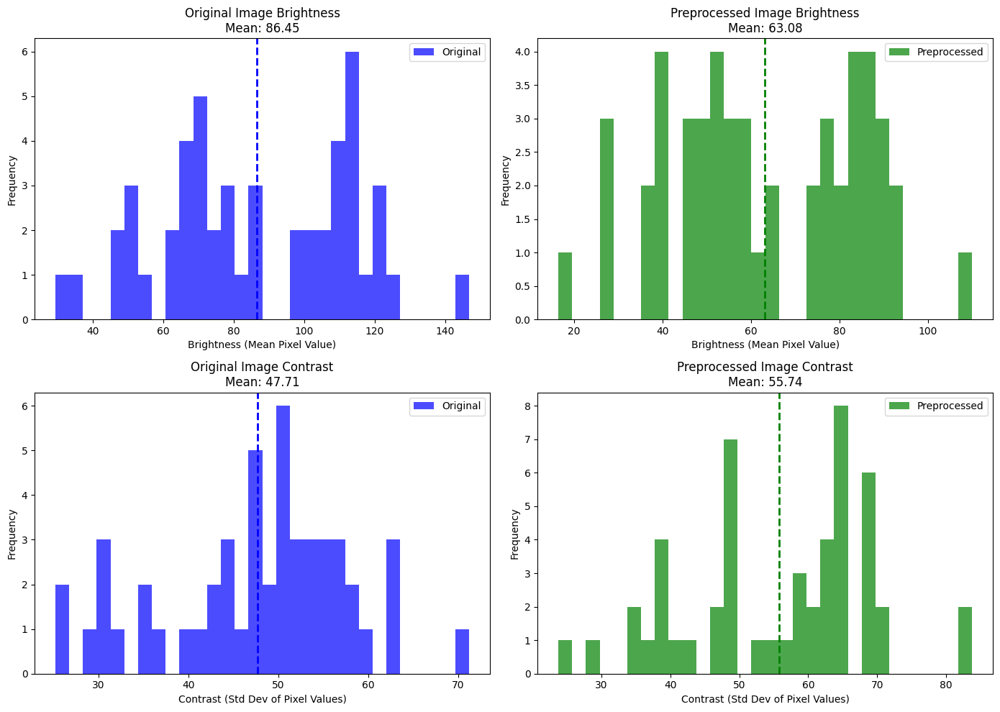


IMAGE QUALITY METRICS COMPARISON

Brightness (mean pixel value):
  Original:     86.45 ± 26.97
  Preprocessed: 63.08 ± 21.58
  Improvement:  -27.03%

Contrast (std dev of pixel values):
  Original:     47.71 ± 10.36
  Preprocessed: 55.74 ± 13.29
  Improvement:  +16.82%


In [43]:
# Analyze a sample of images to compare before and after preprocessing
sample_size = min(50, len(train_image_paths))
sample_indices = random.sample(range(len(train_image_paths)), sample_size)

original_brightness = []
original_contrast = []
preprocessed_brightness = []
preprocessed_contrast = []

print(f"Analyzing {sample_size} images for quality metrics...")

for idx in sample_indices:
    img_path = train_image_paths[idx]
    lbl_path = train_label_paths[idx]
    
    # Original image
    orig_img = cv2.imread(img_path)
    if orig_img is not None:
        gray_orig = cv2.cvtColor(orig_img, cv2.COLOR_BGR2GRAY)
        original_brightness.append(np.mean(gray_orig))
        original_contrast.append(np.std(gray_orig))
    
    # Preprocessed image (without normalization for fair comparison)
    try:
        _, _, _, display_img = preprocess_image(img_path, lbl_path, 
                                                target_size=(800, 800),
                                                # apply_color_correction=True,
                                                normalize=False)
        gray_proc = cv2.cvtColor(display_img, cv2.COLOR_BGR2GRAY)
        preprocessed_brightness.append(np.mean(gray_proc))
        preprocessed_contrast.append(np.std(gray_proc))
    except:
        pass

# Plot comparison
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Brightness comparison
axes[0, 0].hist(original_brightness, bins=30, alpha=0.7, color='blue', label='Original')
axes[0, 0].axvline(np.mean(original_brightness), color='blue', linestyle='--', linewidth=2)
axes[0, 0].set_xlabel('Brightness (Mean Pixel Value)')
axes[0, 0].set_ylabel('Frequency')
axes[0, 0].set_title(f'Original Image Brightness\nMean: {np.mean(original_brightness):.2f}')
axes[0, 0].legend()

axes[0, 1].hist(preprocessed_brightness, bins=30, alpha=0.7, color='green', label='Preprocessed')
axes[0, 1].axvline(np.mean(preprocessed_brightness), color='green', linestyle='--', linewidth=2)
axes[0, 1].set_xlabel('Brightness (Mean Pixel Value)')
axes[0, 1].set_ylabel('Frequency')
axes[0, 1].set_title(f'Preprocessed Image Brightness\nMean: {np.mean(preprocessed_brightness):.2f}')
axes[0, 1].legend()

# Contrast comparison
axes[1, 0].hist(original_contrast, bins=30, alpha=0.7, color='blue', label='Original')
axes[1, 0].axvline(np.mean(original_contrast), color='blue', linestyle='--', linewidth=2)
axes[1, 0].set_xlabel('Contrast (Std Dev of Pixel Values)')
axes[1, 0].set_ylabel('Frequency')
axes[1, 0].set_title(f'Original Image Contrast\nMean: {np.mean(original_contrast):.2f}')
axes[1, 0].legend()

axes[1, 1].hist(preprocessed_contrast, bins=30, alpha=0.7, color='green', label='Preprocessed')
axes[1, 1].axvline(np.mean(preprocessed_contrast), color='green', linestyle='--', linewidth=2)
axes[1, 1].set_xlabel('Contrast (Std Dev of Pixel Values)')
axes[1, 1].set_ylabel('Frequency')
axes[1, 1].set_title(f'Preprocessed Image Contrast\nMean: {np.mean(preprocessed_contrast):.2f}')
axes[1, 1].legend()

plt.tight_layout()
plt.show()

# Print statistics
print("\n" + "=" * 60)
print("IMAGE QUALITY METRICS COMPARISON")
print("=" * 60)
print(f"\nBrightness (mean pixel value):")
print(f"  Original:     {np.mean(original_brightness):.2f} ± {np.std(original_brightness):.2f}")
print(f"  Preprocessed: {np.mean(preprocessed_brightness):.2f} ± {np.std(preprocessed_brightness):.2f}")
print(f"  Improvement:  {((np.mean(preprocessed_brightness) - np.mean(original_brightness)) / np.mean(original_brightness) * 100):+.2f}%")

print(f"\nContrast (std dev of pixel values):")
print(f"  Original:     {np.mean(original_contrast):.2f} ± {np.std(original_contrast):.2f}")
print(f"  Preprocessed: {np.mean(preprocessed_contrast):.2f} ± {np.std(preprocessed_contrast):.2f}")
print(f"  Improvement:  {((np.mean(preprocessed_contrast) - np.mean(original_contrast)) / np.mean(original_contrast) * 100):+.2f}%")
print("=" * 60)

## Step 3: Data Augmentation

In [77]:
def clip_and_filter(boxes_xyxy, labels, W, H, min_area=16):
    boxes = boxes_xyxy.copy()

    # Clip
    boxes[:, 0] = np.clip(boxes[:, 0], 0, W - 1)
    boxes[:, 2] = np.clip(boxes[:, 2], 0, W - 1)
    boxes[:, 1] = np.clip(boxes[:, 1], 0, H - 1)
    boxes[:, 3] = np.clip(boxes[:, 3], 0, H - 1)

    # Filter invalid boxes
    ws = boxes[:, 2] - boxes[:, 0]
    hs = boxes[:, 3] - boxes[:, 1]
    keep = (ws > 1) & (hs > 1) & ((ws * hs) >= min_area)

    return boxes[keep], labels[keep]

def horizontal_flip(image_rgb, boxes_xyxy, W):
    image_rgb = image_rgb[:, ::-1, :].copy()

    # fix boxes for flipped image
    x1 = boxes_xyxy[:, 0].copy()
    x2 = boxes_xyxy[:, 2].copy()
    boxes_xyxy[:, 0] = W - x2
    boxes_xyxy[:, 2] = W - x1
    
    return image_rgb, boxes_xyxy

def modify_contrast_and_brightness(image_rgb):
    contrast = random.uniform(0.6, 1.6)
    brightness = random.uniform(-40, 40)
    img = image_rgb.astype(np.float32)
    img = contrast * img + brightness
    
    return np.clip(img, 0, 255).astype(np.uint8)

def apply_blur(image_rgb):
    if random.random() < 0.5:
        # Gaussian blur
        k = random.choice([3, 5, 7])
        return cv2.GaussianBlur(image_rgb, (k, k), sigmaX=0)
    else:
        # Motion blur
        k = random.choice([5, 7, 9])
        kernel = np.zeros((k, k), dtype=np.float32)
        if random.random() < 0.5:
            kernel[k // 2, :] = 1.0  # horizontal
        else:
            kernel[:, k // 2] = 1.0  # vertical
        kernel /= kernel.sum()
        return cv2.filter2D(image_rgb, -1, kernel)

def add_noise(image_rgb):
    img = image_rgb.astype(np.float32)

    if random.random() < 0.5:
        # Additive Gaussian noise
        sigma = random.uniform(5.0, 20.0)
        noise = np.random.normal(0.0, sigma, size=img.shape).astype(np.float32)
        img = img + noise
    else:
        # Speckle noise
        sigma = random.uniform(0.05, 0.20)
        noise = np.random.normal(0.0, sigma, size=img.shape).astype(np.float32)
        img = img + img * noise

    return np.clip(img, 0, 255).astype(np.uint8)
    
def random_crop(image_rgb, boxes_xyxy, labels, W, H, min_scale=0.6, min_area=16):
    scale = random.uniform(min_scale, 1.0)
    crop_w = int(W * scale)
    crop_h = int(H * scale)

    if crop_w < 2 or crop_h < 2:
        return image_rgb, boxes_xyxy, labels, W, H

    x0 = random.randint(0, W - crop_w)
    y0 = random.randint(0, H - crop_h)
    x1 = x0 + crop_w
    y1 = y0 + crop_h

    cropped = image_rgb[y0:y1, x0:x1, :].copy()

    # Update boxes
    boxes = boxes_xyxy.copy()
    new_boxes = boxes.copy()

    # Intersect with crop area
    new_boxes[:, 0] = np.maximum(boxes[:, 0], x0)
    new_boxes[:, 1] = np.maximum(boxes[:, 1], y0)
    new_boxes[:, 2] = np.minimum(boxes[:, 2], x1)
    new_boxes[:, 3] = np.minimum(boxes[:, 3], y1)

    new_boxes[:, 0] -= x0
    new_boxes[:, 2] -= x0
    new_boxes[:, 1] -= y0
    new_boxes[:, 3] -= y0

    new_W, new_H = crop_w, crop_h

    new_boxes, new_labels = clip_and_filter(new_boxes, labels, new_W, new_H, min_area=min_area)
    
    return cropped, new_boxes, new_labels, new_W, new_H

def random_rotate(image_rgb, boxes_xyxy, labels, W, H, min_area=16):
    angle_deg = random.uniform(-45.0, 45.0)
    
    cx, cy = W / 2.0, H / 2.0
    M = cv2.getRotationMatrix2D((cx, cy), angle_deg, 1.0)

    rotated = cv2.warpAffine(
        image_rgb,
        M,
        (W, H),
        flags=cv2.INTER_LINEAR,
        borderMode=cv2.BORDER_CONSTANT,
        borderValue=(0, 0, 0),
    )

    boxes = boxes_xyxy.copy()

    # Build corners for each box
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]

    corners = np.stack([
        np.stack([x1, y1], axis=1),
        np.stack([x2, y1], axis=1),
        np.stack([x2, y2], axis=1),
        np.stack([x1, y2], axis=1),
    ], axis=1)  # (N,4,2)

    # Apply rotation matrix to corners
    ones = np.ones((corners.shape[0], corners.shape[1], 1), dtype=np.float32)
    corners_h = np.concatenate([corners.astype(np.float32), ones], axis=2)
    rotated_corners = np.zeros((corners.shape[0], corners.shape[1], 2), dtype=np.float32)
    rotated_corners[..., 0] = corners_h[..., 0] * M[0, 0] + corners_h[..., 1] * M[0, 1] + M[0, 2]
    rotated_corners[..., 1] = corners_h[..., 0] * M[1, 0] + corners_h[..., 1] * M[1, 1] + M[1, 2]

    # Construct new boxes
    new_x1 = rotated_corners[..., 0].min(axis=1)
    new_y1 = rotated_corners[..., 1].min(axis=1)
    new_x2 = rotated_corners[..., 0].max(axis=1)
    new_y2 = rotated_corners[..., 1].max(axis=1)
    new_boxes = np.stack([new_x1, new_y1, new_x2, new_y2], axis=1)
    
    new_boxes, new_labels = clip_and_filter(new_boxes, labels, W, H, min_area=min_area)

    return rotated, new_boxes, new_labels

def apply_augmentation(image_rgb, boxes_xyxy, labels, W, H, aug_num=0):
    # aug_num determines the type of augmentation. when aug_num is zero, all augmentations have a chance to be applied.
    
    if aug_num == 0 and random.random() < 0.5 or aug_num == 1:
        image_rgb, boxes_xyxy = horizontal_flip(image_rgb, boxes_xyxy, W)

    if aug_num == 0 and random.random() < 0.4 or aug_num == 2:
        image_rgb = modify_contrast_and_brightness(image_rgb)
        
    if aug_num == 0 and random.random() < 0.2 or aug_num == 3:
        image_rgb = apply_blur(image_rgb)

    if aug_num == 0 and random.random() < 0.2 or aug_num == 4:
        image_rgb = add_noise(image_rgb)

    if aug_num == 0 and random.random() < 0.3 or aug_num == 5:
        image_rgb, boxes_xyxy, labels, H, W = random_crop(image_rgb, boxes_xyxy, labels, W, H)

    if aug_num == 0 and random.random() < 0.3 or aug_num == 6:
        image_rgb, boxes_xyxy, labels = random_rotate(image_rgb, boxes_xyxy, labels, W, H)
    
    return image_rgb, boxes_xyxy, labels

### Before/After Augmentation Visualization

Visualizing augmentation effects on random samples...


Sample: IMG_8578_MOV-2_jpg.rf.2e5101d836971fa36cc0876c718069bb.jpg


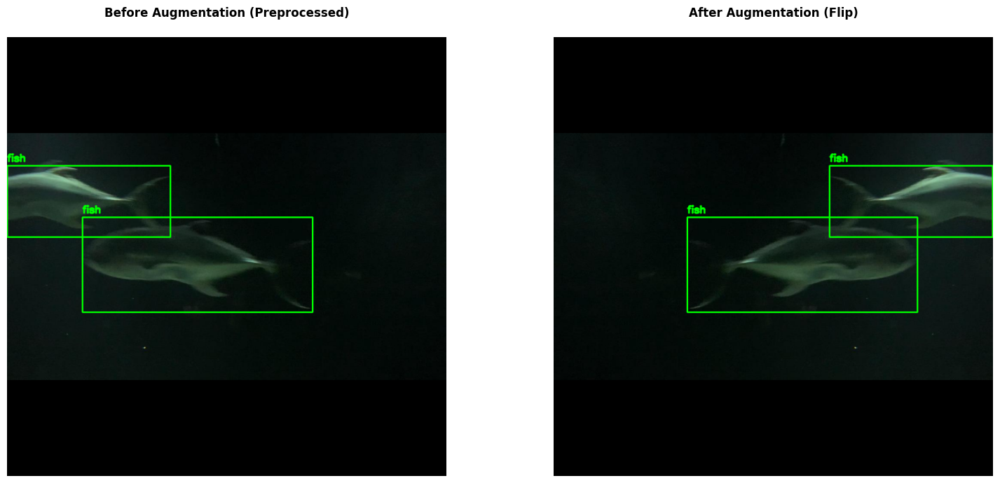


Sample: IMG_8412_jpg.rf.a7669aef0d6247193978c21e8581e57f.jpg


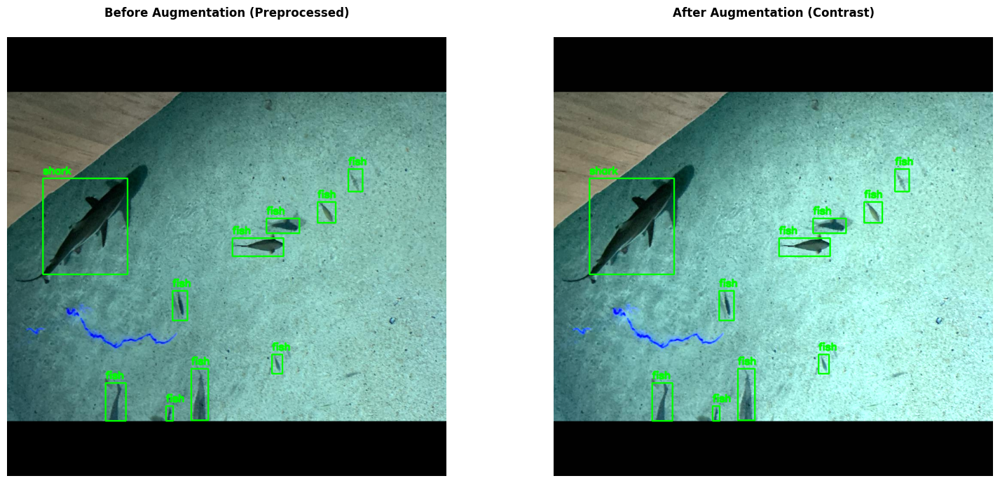


Sample: IMG_8522_jpg.rf.de6f1dbe20d278d2b0052bc448aa93d8.jpg


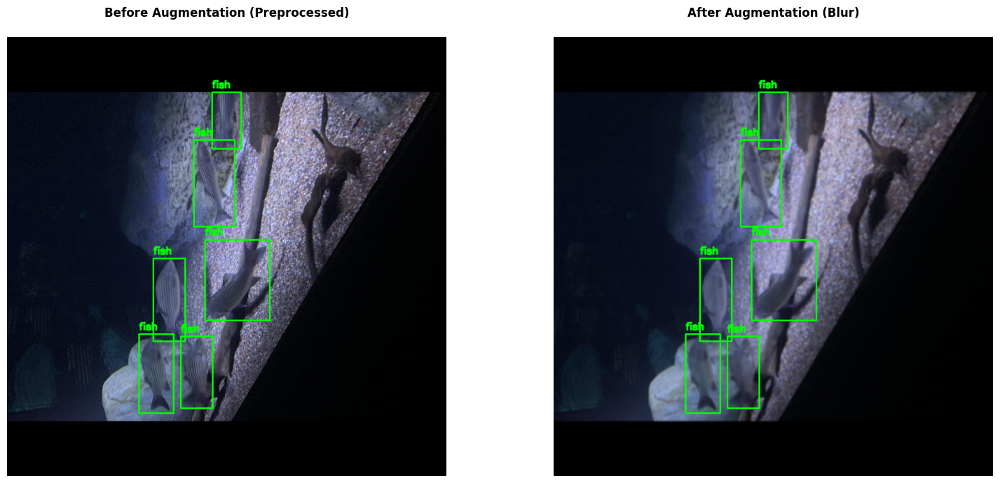


Sample: IMG_2647_jpeg_jpg.rf.9b83da86e81bb2e5ba772305e2172d63.jpg


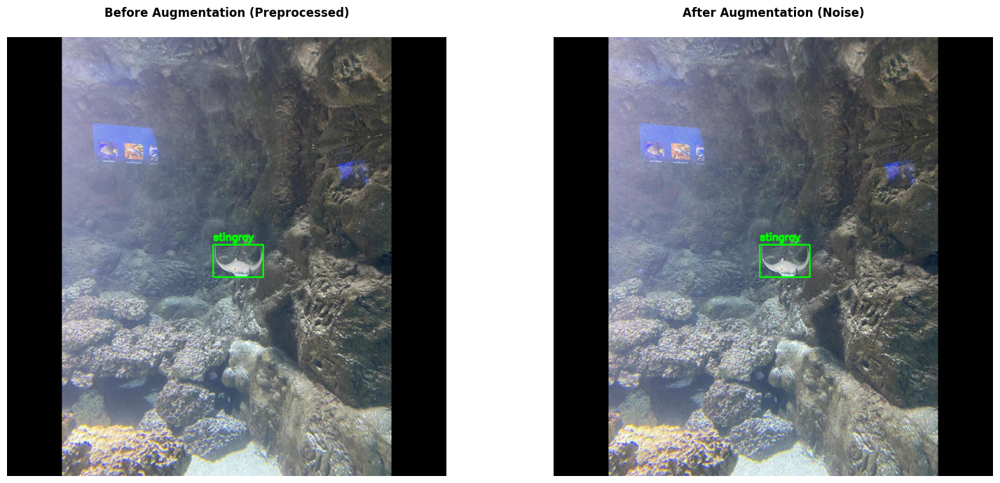


Sample: IMG_2327_jpeg_jpg.rf.23ca4add8919548516415c9fe02eedf6.jpg


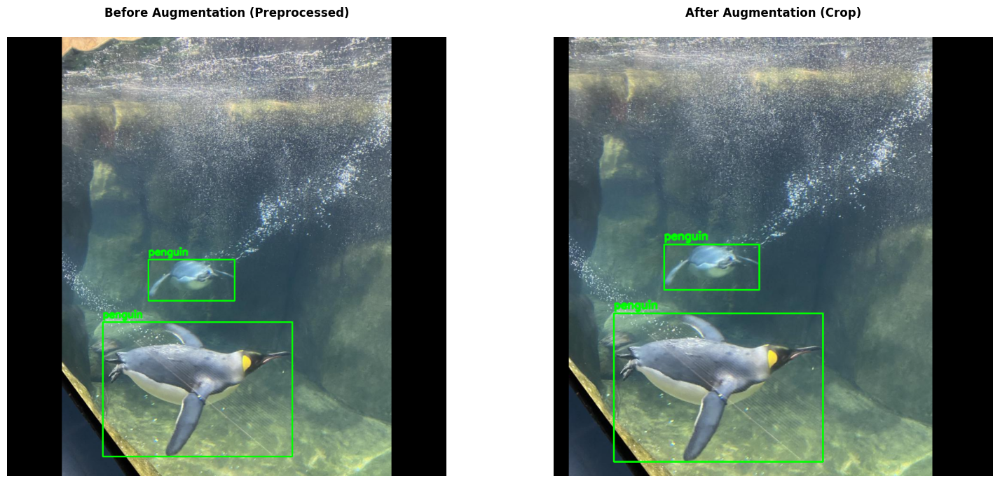


Sample: IMG_3156_jpeg_jpg.rf.330ea62dfe1c5108c408331acc17cd6a.jpg


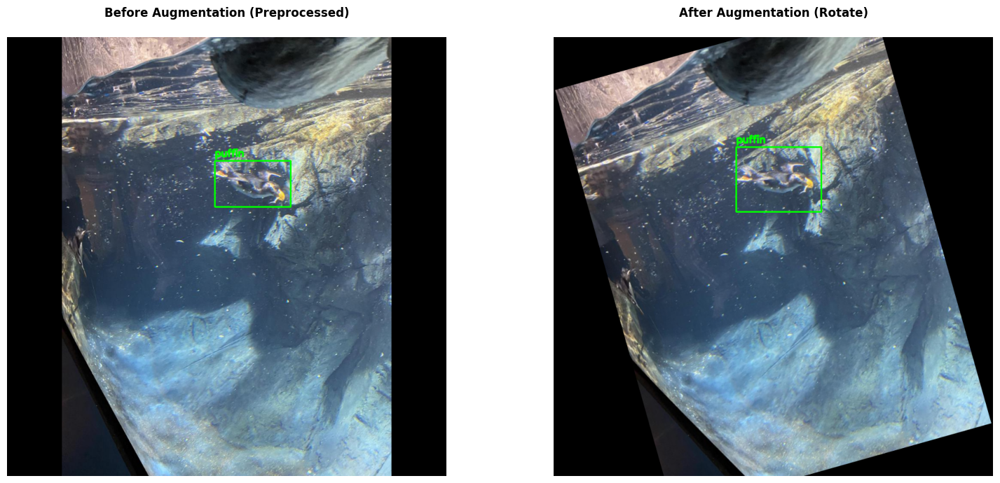

In [81]:
# Helpers

def load_yolo_labels_txt(label_path):
    labels = []
    with open(label_path, 'r') as f:
        for line in f.readlines():
            parts = list(map(float, line.strip().split()))
            labels.append(parts) # [class, cx, cy, w, h]
    return labels

def yolo_to_xyxy_pixels(labels_yolo, W, H):
    boxes_xyxy = []
    class_ids = []
    for row in labels_yolo:
        class_id = int(row[0])
        cx, cy, w, h = row[1:]
        x1 = (cx - w/2) * W
        y1 = (cy - h/2) * H
        x2 = (cx + w/2) * W
        y2 = (cy + h/2) * H
        boxes_xyxy.append([x1, y1, x2, y2])
        class_ids.append(class_id)
    return np.array(boxes_xyxy, dtype=np.float32), np.array(class_ids, dtype=np.int64)

def draw_boxes_on_image(image_rgb, boxes_xyxy, class_ids, class_names, color=(0,255,0)):
    img = image_rgb.copy()
    for box, cid in zip(boxes_xyxy, class_ids):
        x1, y1, x2, y2 = box.astype(int)
        cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
        cv2.putText(img, class_names[int(cid)], (x1, max(0, y1-8)),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2, cv2.LINE_AA)
    return img

# Plot function
def plot_augmentation_comparison(image_path, label_path, aug_num, target_size=(800, 800)):
    # Load original
    original_bgr = cv2.imread(image_path)
    original_rgb = cv2.cvtColor(original_bgr, cv2.COLOR_BGR2RGB)
    H_orig, W_orig = original_rgb.shape[:2]

    # Load labels
    labels_yolo = load_yolo_labels_txt(label_path)
    
    # Preprocess
    boxes_tuples = [(int(row[0]), row[1], row[2], row[3], row[4]) for row in labels_yolo]

    processed_bgr, boxes_adjusted, _ = resize_image_and_boxes(original_bgr, boxes_tuples, target_size=target_size)
    processed_rgb = cv2.cvtColor(processed_bgr, cv2.COLOR_BGR2RGB)
    H_proc, W_proc = processed_rgb.shape[:2]

    # boxes_adjusted is list of (class_id, cx_norm, cy_norm, w_norm, h_norm)
    labels_proc_yolo = []
    for b in boxes_adjusted:
        labels_proc_yolo.append([b[0], b[1], b[2], b[3], b[4]])

    boxes_proc_xyxy, class_ids_proc = yolo_to_xyxy_pixels(labels_proc_yolo, W_proc, H_proc)

    # Draw before augmentation
    preprocessed_vis = draw_boxes_on_image(processed_rgb, boxes_proc_xyxy, class_ids_proc, class_names)

    # Apply augmentations
    aug_rgb, aug_boxes_xyxy, aug_class_ids = apply_augmentation(processed_rgb.copy(), boxes_proc_xyxy.copy(),
                                                                        class_ids_proc.copy(), W_proc, H_proc, aug_num=aug_num+1)

    # Draw after augmentation
    aug_vis = draw_boxes_on_image(aug_rgb, aug_boxes_xyxy, aug_class_ids, class_names)

    # Plot comparison
    fig, axes = plt.subplots(1, 2, figsize=(16, 7))

    axes[0].imshow(preprocessed_vis)
    axes[0].set_title('Before Augmentation (Preprocessed)\n', fontsize=12, fontweight='bold')
    axes[0].axis('off')

    aug_type = ['Flip', 'Contrast', 'Blur', 'Noise', 'Crop', 'Rotate']
    
    axes[1].imshow(aug_vis)
    axes[1].set_title(f'After Augmentation ({aug_type[aug_num]})\n', fontsize=12, fontweight='bold')
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

print("Visualizing augmentation effects on random samples...\n")

num_samples = 6
random_indices = random.sample(range(len(train_image_paths)), min(num_samples, len(train_image_paths)))

for i, idx in enumerate(random_indices):
    img_path = train_image_paths[idx]
    lbl_path = train_label_paths[idx]
    print(f"\nSample: {os.path.basename(img_path)}")
    plot_augmentation_comparison(img_path, lbl_path, i, target_size=(800, 800))

### Mosaic Augmentation

In [80]:
def resize_img_and_boxes_xyxy(image_rgb, boxes_xyxy, new_W, new_H):
    H, W = image_rgb.shape[:2]
    img_resized = cv2.resize(image_rgb, (new_W, new_H), interpolation=cv2.INTER_LINEAR)

    sx = new_W / W
    sy = new_H / H
    boxes = boxes_xyxy.copy()
    boxes[:, 0] *= sx
    boxes[:, 2] *= sx
    boxes[:, 1] *= sy
    boxes[:, 3] *= sy
    return img_resized, boxes


def mosaic_2x2(images_rgb, boxes_list, labels_list, out_W, out_H, min_area=16):
    mosaic_img = np.zeros((out_H, out_W, 3), dtype=np.uint8)

    # Tile size
    tile_W = out_W // 2
    tile_H = out_H // 2

    # offsets for 4 Tiles
    offsets = [
        (0, 0), # Top-Left
        (tile_W, 0), # Top-Right
        (0, tile_H), # Bottom-Left
        (tile_W, tile_H) # Bottom-Right
    ]

    all_boxes = []
    all_labels = []

    for i in range(4):
        x_off, y_off = offsets[i]

        img = images_rgb[i]
        boxes = boxes_list[i]
        labs = labels_list[i]

        # Resize each image to tile size
        img_r, boxes_r = resize_img_and_boxes_xyxy(img, boxes, tile_W, tile_H)

        # Add tile to mosaic_img
        mosaic_img[y_off:y_off + tile_H, x_off:x_off + tile_W] = img_r

        # Shift boxes by offset
        boxes_shift = boxes_r.copy()
        boxes_shift[:, [0, 2]] += x_off
        boxes_shift[:, [1, 3]] += y_off

        all_boxes.append(boxes_shift)
        all_labels.append(labs)

    mosaic_boxes = np.concatenate(all_boxes, axis=0) if len(all_boxes) else np.zeros((0,4), dtype=np.float32)
    mosaic_labels = np.concatenate(all_labels, axis=0) if len(all_labels) else np.zeros((0,), dtype=np.int64)

    mosaic_boxes, mosaic_labels = clip_and_filter(mosaic_boxes, mosaic_labels, out_W, out_H, min_area=min_area)

    return mosaic_img, mosaic_boxes, mosaic_labels


### Mosaic Augmentation Visualization

Mosaic Sample 1


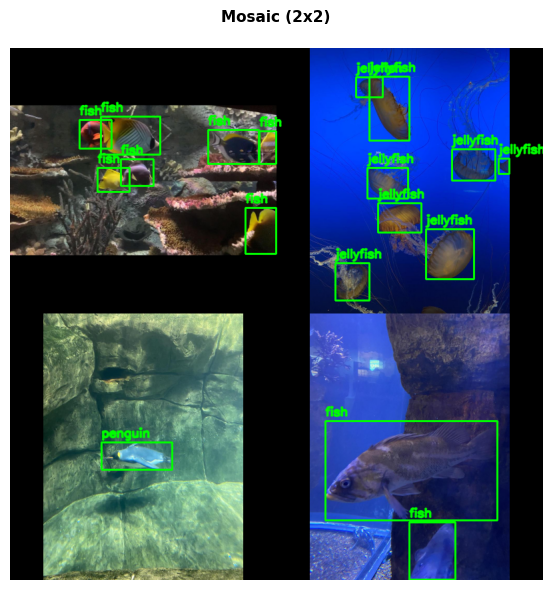

Mosaic Sample 2


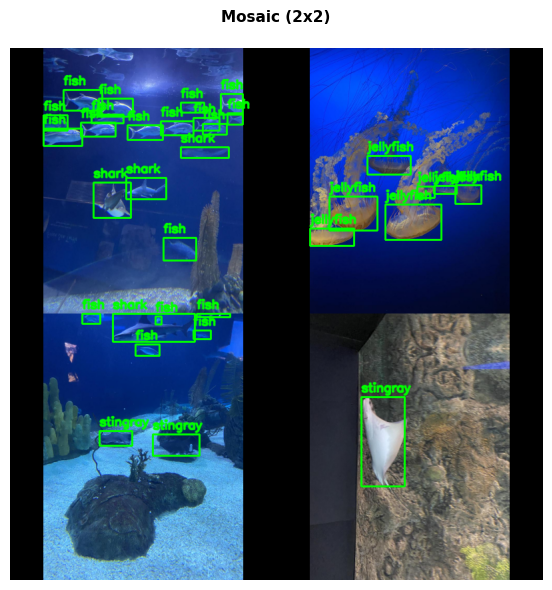

Mosaic Sample 3


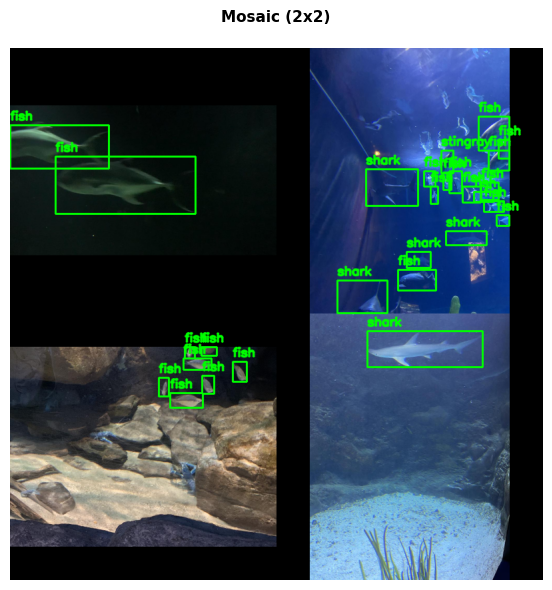

In [85]:
def plot_mosaic_comparison(train_image_paths, train_label_paths, target_size=(800, 800)):
    out_W, out_H = target_size

    idxs = random.sample(range(len(train_image_paths)), 4)

    images_rgb = []
    boxes_list = []
    labels_list = []

    for idx in idxs:
        img_path = train_image_paths[idx]
        lbl_path = train_label_paths[idx]

        # Load original
        original_bgr = cv2.imread(img_path)
        if original_bgr is None:
            continue
        labels_yolo = load_yolo_labels_txt(lbl_path)

        # Preprocess
        boxes_tuples = [(int(row[0]), row[1], row[2], row[3], row[4]) for row in labels_yolo]
        processed_bgr, boxes_adjusted, _ = resize_image_and_boxes(original_bgr, boxes_tuples, target_size=target_size)
        processed_rgb = cv2.cvtColor(processed_bgr, cv2.COLOR_BGR2RGB)
        H_proc, W_proc = processed_rgb.shape[:2]

        # Convert adjusted boxes to xyxy pixels
        labels_proc_yolo = [[b[0], b[1], b[2], b[3], b[4]] for b in boxes_adjusted]
        boxes_xyxy, class_ids = yolo_to_xyxy_pixels(labels_proc_yolo, W_proc, H_proc)

        # Store
        images_rgb.append(processed_rgb)
        boxes_list.append(boxes_xyxy)
        labels_list.append(class_ids)

    # Build mosaic
    mosaic_img, mosaic_boxes, mosaic_labels = mosaic_2x2(images_rgb, boxes_list, labels_list, out_W, out_H, min_area=16)
    mosaic_vis = draw_boxes_on_image(mosaic_img, mosaic_boxes, mosaic_labels, class_names)

    # Plot
    fig, axes = plt.subplots(1, 1, figsize=(26, 6))

    axes.imshow(mosaic_vis)
    axes.set_title("Mosaic (2x2)\n", fontsize=11, fontweight='bold')
    axes.axis('off')

    plt.tight_layout()
    plt.show()

num_samples = 3
for s in range(num_samples):
    print(f"Mosaic Sample {s+1}")
    plot_mosaic_comparison(train_image_paths, train_label_paths, target_size=(800, 800))

## Step 4: Create Dataloader and define collate_fn

### Create the Dataset

In [91]:
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader

class UnderwaterObjectDetectionDataset(Dataset):

    def __init__(self, image_paths, label_paths, class_names, config,
                 transform=None, train=True, mosaic_prob=0.3):

        self.image_paths = image_paths
        self.label_paths = label_paths
        self.class_names = class_names
        self.config = config
        self.transform = transform
        self.train = train
        self.mosaic_prob = mosaic_prob

    def __len__(self):
        return len(self.image_paths)

    # Normal Load
    def load_single_sample(self, idx):

        img_path = self.image_paths[idx]
        lbl_path = self.label_paths[idx]

        image = cv2.imread(img_path)
        if image is None:
            raise ValueError(f"Cannot load image: {img_path}")

        labels_yolo = load_yolo_labels_txt(lbl_path)

        boxes_tuples = [(int(r[0]), r[1], r[2], r[3], r[4]) for r in labels_yolo]

        image, boxes_adjusted, _ = resize_image_and_boxes(image, boxes_tuples, 
                                                          target_size=self.config.get('target_size', (800, 800)),
                                                          keep_aspect_ratio=self.config.get('keep_aspect_ratio', True))

        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        H, W = image_rgb.shape[:2]

        # Convert YOLO → xyxy pixels
        labels_proc = [[b[0], b[1], b[2], b[3], b[4]] for b in boxes_adjusted]
        boxes_xyxy, class_ids = yolo_to_xyxy_pixels(labels_proc, W, H)

        return image_rgb, boxes_xyxy, class_ids

    # Mosaic
    def load_mosaic(self, idx):

        indices = [idx] + random.sample(range(len(self)), 3)

        images = []
        boxes_list = []
        labels_list = []

        for i in indices:
            img, boxes, labels = self.load_single_sample(i)
            images.append(img)
            boxes_list.append(boxes)
            labels_list.append(labels)

        out_W, out_H = self.config.get('target_size', (800, 800))
        mosaic_img, mosaic_boxes, mosaic_labels = mosaic_2x2(images, boxes_list, labels_list, out_W, out_H)

        return mosaic_img, mosaic_boxes, mosaic_labels

    
    def __getitem__(self, idx):

        # Mosaic or normal load
        if self.train and random.random() < self.mosaic_prob:
            image_rgb, boxes_xyxy, labels = self.load_mosaic(idx)
        else:
            image_rgb, boxes_xyxy, labels = self.load_single_sample(idx)

        H, W = image_rgb.shape[:2]

        # Augmentations
        if self.train:
            image_rgb, boxes_xyxy, labels = apply_augmentation(image_rgb, boxes_xyxy, labels, W, H, aug_num=0)

        # Convert to tensor
        boxes_tensor = torch.as_tensor(boxes_xyxy, dtype=torch.float32)
        labels_tensor = torch.as_tensor(labels, dtype=torch.int64)

        # Normalize image
        norm_method = self.config.get('normalization_method', 'standard')
        if norm_method == 'standard':
            image_normalized = image_rgb.astype(np.float32) / 255.0
        elif norm_method == 'imagenet':
            mean = np.array([0.485, 0.456, 0.406])
            std = np.array([0.229, 0.224, 0.225])
            image_normalized = (image_rgb.astype(np.float32) / 255.0 - mean) / std
        else:
            image_normalized = image_rgb.astype(np.float32) / 255.0
        if self.transform:
            image_tensor = self.transform(image_tensor)

        target = {
            "boxes": boxes_tensor,
            "labels": labels_tensor,
            "image_id": torch.tensor([idx])
        }

        return image_tensor, target

### Define collate_fn

In [92]:
def collate_fn(batch, pad_label=-1):
    """
    batch: list of (image, target_dict)
      - image: (C,H,W)
      - target_dict['boxes']: (N,4)
      - target_dict['labels']: (N,)
    """
    
    images = [item[0] for item in batch]
    targets = [item[1] for item in batch]

    B = len(images)
    images = torch.stack(images, dim=0)

    num_objs = [t["boxes"].shape[0] for t in targets] 
    M = max(num_objs) if len(num_objs) > 0 else 0

    boxes_padded = torch.zeros((B, M, 4), dtype=torch.float32)
    labels_padded = torch.full((B, M), pad_label, dtype=torch.int64)
    mask = torch.zeros((B, M), dtype=torch.bool)

    for i, t in enumerate(targets):
        n = t["boxes"].shape[0]
        if n == 0:
            continue
        boxes_padded[i, :n] = t["boxes"]
        labels_padded[i, :n] = t["labels"]
        mask[i, :n] = True

    return images, boxes_padded, labels_padded, mask


### Create Dataloader

In [97]:
train_loader = DataLoader(
    train_dataset,
    batch_size=4,
    shuffle=True,
    collate_fn=collate_fn
)

# Batch sample
images, boxes_padded, labels_padded, mask = next(iter(train_loader))

print("Batch shapes:")
print("Images shape:", images.shape)               # (B,C,H,W)
print("Boxes padded shape:", boxes_padded.shape)   # (B,M,4)
print("Labels padded shape:", labels_padded.shape) # (B,M)
print("Mask shape:", mask.shape)                   # (B,M)

print("\nMax objects in this batch (M):", boxes_padded.shape[1])

# Test padding
for i in range(images.shape[0]):
    real_objects = mask[i].sum().item()
    
    print(f"\nImage {i}:")
    print("  Number of objects:", real_objects)
    print("  Mask row:", mask[i].int().tolist())
    print("  Labels row:", labels_padded[i].tolist())


Batch shapes:
Images shape: torch.Size([4, 3, 800, 800])
Boxes padded shape: torch.Size([4, 14, 4])
Labels padded shape: torch.Size([4, 14])
Mask shape: torch.Size([4, 14])

Max objects in this batch (M): 14

Image 0:
  Number of objects: 4
  Mask row: [1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
  Labels row: [6, 6, 4, 6, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]

Image 1:
  Number of objects: 8
  Mask row: [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0]
  Labels row: [0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, -1, -1]

Image 2:
  Number of objects: 9
  Mask row: [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
  Labels row: [0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, -1]

Image 3:
  Number of objects: 14
  Mask row: [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
  Labels row: [0, 4, 0, 0, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0]


### Step 6: Create PyTorch Dataset Class with Preprocessing

This custom dataset class integrates all preprocessing steps and prepares the data for Faster R-CNN training.

In [44]:
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms

class UnderwaterObjectDetectionDataset(Dataset):
    """
    Custom PyTorch Dataset for underwater object detection with preprocessing.
    Suitable for Faster R-CNN and other object detection models.
    """
    
    def __init__(self, image_paths, label_paths, class_names, config, transform=None, train=True):
        """
        Args:
            image_paths: List of image file paths
            label_paths: List of corresponding label file paths
            class_names: List of class names
            config: Preprocessing configuration dictionary
            transform: Optional additional torchvision transforms
        """
        self.image_paths = image_paths
        self.label_paths = label_paths
        self.class_names = class_names
        self.config = config
        self.transform = transform
        
    def __len__(self):
        return len(self.image_paths)
    
    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        lbl_path = self.label_paths[idx]
        
        # Load and preprocess image
        image = cv2.imread(img_path)
        if image is None:
            raise ValueError(f"Cannot load image: {img_path}")
        
        # Load bounding boxes
        boxes = []
        labels = []
        with open(lbl_path, 'r') as f:
            for line in f.readlines():
                parts = list(map(float, line.strip().split()))
                class_id = int(parts[0])
                x_c, y_c, w, h = parts[1:]
                boxes.append([x_c, y_c, w, h])
                labels.append(class_id)
        
        # Resize image and adjust boxes
        target_size = self.config.get('target_size', (800, 800))
        boxes_tuples = [(labels[i], boxes[i][0], boxes[i][1], boxes[i][2], boxes[i][3]) 
                       for i in range(len(boxes))]
        
        image, boxes_adjusted, _ = resize_image_and_boxes(
            image, boxes_tuples, 
            target_size=target_size,
            keep_aspect_ratio=self.config.get('keep_aspect_ratio', True)
        )
        
        # Convert boxes from YOLO format (center, normalized) to [x_min, y_min, x_max, y_max] format
        H, W = image.shape[:2]
        boxes_xyxy = []
        labels_adjusted = []
        
        for box in boxes_adjusted:
            class_id, x_c, y_c, w, h = box
            
            # Convert to pixel coordinates
            x_center = x_c * W
            y_center = y_c * H
            width = w * W
            height = h * H
            
            # Convert to [x_min, y_min, x_max, y_max]
            x_min = x_center - width / 2
            y_min = y_center - height / 2
            x_max = x_center + width / 2
            y_max = y_center + height / 2
            
            boxes_xyxy.append([x_min, y_min, x_max, y_max])
            labels_adjusted.append(class_id)

        # Apply augmentations if training
        if self.train:
            image_rgb, boxes_xyxy, labels_np = self.apply_augmentations(image_rgb, boxes_xyxy, labels_np, W, H)
        
        # Convert to tensors
        boxes_tensor = torch.as_tensor(boxes_xyxy, dtype=torch.float32)
        labels_tensor = torch.as_tensor(labels_adjusted, dtype=torch.int64)
        
        # Convert image to RGB and normalize
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Normalize image
        norm_method = self.config.get('normalization_method', 'standard')
        if norm_method == 'standard':
            image_normalized = image_rgb.astype(np.float32) / 255.0
        elif norm_method == 'imagenet':
            mean = np.array([0.485, 0.456, 0.406])
            std = np.array([0.229, 0.224, 0.225])
            image_normalized = (image_rgb.astype(np.float32) / 255.0 - mean) / std
        else:
            image_normalized = image_rgb.astype(np.float32) / 255.0
        
        # Convert to tensor (C, H, W) format
        image_tensor = torch.from_numpy(image_normalized).permute(2, 0, 1).float()
        
        # Apply additional transforms if provided
        if self.transform:
            image_tensor = self.transform(image_tensor)
        
        # Create target dictionary (format expected by Faster R-CNN)
        target = {
            'boxes': boxes_tensor,
            'labels': labels_tensor,
            'image_id': torch.tensor([idx])
        }
        
        return image_tensor, target


# Create dataset instance
print("Creating dataset with preprocessing...")
train_dataset = UnderwaterObjectDetectionDataset(
    image_paths=train_image_paths,
    label_paths=train_label_paths,
    class_names=class_names,
    config=preprocessing_config
)

print(f"\nDataset created successfully!")
print(f"  - Total samples: {len(train_dataset)}")
print(f"  - Classes: {len(class_names)}")
print(f"  - Image shape after preprocessing: {preprocessing_config['target_size'] + (3,)}")  # (H, W, C)

# Test the dataset
print("\nTesting dataset by loading a sample...")
sample_img, sample_target = train_dataset[0]
print(f"  - Image tensor shape: {sample_img.shape}")
print(f"  - Number of objects: {len(sample_target['boxes'])}")
print(f"  - Boxes shape: {sample_target['boxes'].shape}")
print(f"  - Labels: {sample_target['labels']}")
print(f"  - Image value range: [{sample_img.min():.3f}, {sample_img.max():.3f}]")

print("\n✓ Dataset is ready for training!")

Creating dataset with preprocessing...

Dataset created successfully!
  - Total samples: 447
  - Classes: 7
  - Image shape after preprocessing: (800, 800, 3)

Testing dataset by loading a sample...
  - Image tensor shape: torch.Size([3, 800, 800])
  - Number of objects: 34
  - Boxes shape: torch.Size([34, 4])
  - Labels: tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0])
  - Image value range: [0.000, 1.000]

✓ Dataset is ready for training!
